In [1]:
import numpy as np
import matplotlib.pyplot as plt
from functions_to_optimize import f_rastrigin , f_sphere
from CMA_obj import CMA_opt
from PEPG_obj import PEPG_opt
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from SPSA_obj import SPSA_opt
from ADAM_opt import AdamOptimizer
from PSO_obj import PSO_opt
from Finite_diff_grad import FD_opt
from numpy import asarray
from numpy import savetxt

# Sphere function optimization 
In this Notebook we optimize the Rastrigin function with different learning strategies: 

- SPSA 
- CMA
- PEPG
- PSO


In [2]:
#test rastrigin function 
lower_bound = -1
upper_bound = 1
x_1 = np.linspace(lower_bound,upper_bound,200)[:,np.newaxis]
x_2 = np.linspace(lower_bound,upper_bound,200)[:,np.newaxis]

X_1, X_2 = np.meshgrid(x_1,x_2)

X = np.concatenate([X_1.ravel()[:,np.newaxis] , X_2.ravel()[:,np.newaxis]],axis=1)
F = np.zeros([X.shape[0],1])

for i in range(X.shape[0]):
    F[i] = f_sphere(X[i,:])
F_2 = np.reshape(F,[len(x_1),len(x_2)])

F_2 = np.reshape(np.apply_along_axis(f_sphere, 1, X),newshape=[len(x_1),len(x_2)])
# plot using plotly
fig = make_subplots(rows=1, cols=1, subplot_titles=["Rastrigin function"])

fig.add_trace(go.Contour(z=F_2, x=X_1[0, :], y=X_2[:, 0], colorscale='Turbo', contours_coloring='fill',  # Fill the contours
                                line_width=1.5, showscale=True), row=1, col=1)
fig.update_layout(height = 400,width = 500,  margin=dict(l=20, r=20, t=20, b=20))
fig.show()


Initial reward:  1000.0
Best reward at iteration 0: 1156.8863801136636
Best reward at iteration 100: 304.07264903593943
Best reward at iteration 200: 58.752686495926866
Best reward at iteration 300: 11.197934604031463
Best reward at iteration 400: 2.0920162210992608
Best reward at iteration 500: 0.41784344908948
Best reward at iteration 600: 0.07855567499998653
Best reward at iteration 700: 0.015471515348817329
Best reward at iteration 800: 0.0031291052819712607
Best reward at iteration 900: 0.0005958866211004921
Best reward at iteration 1000: 0.00011595182579810762
Best reward at iteration 1100: 2.171468982505455e-05
Best reward at iteration 1200: 4.243508965031985e-06
Best reward at iteration 1300: 7.919064834927046e-07
Best reward at iteration 1400: 1.4569808462526887e-07
Best reward at iteration 1500: 2.7252210570813123e-08
Best reward at iteration 1600: 5.2768915419165305e-09
Best reward at iteration 1700: 1.0382631407949146e-09
Best reward at iteration 1800: 2.0991308706648884e-1

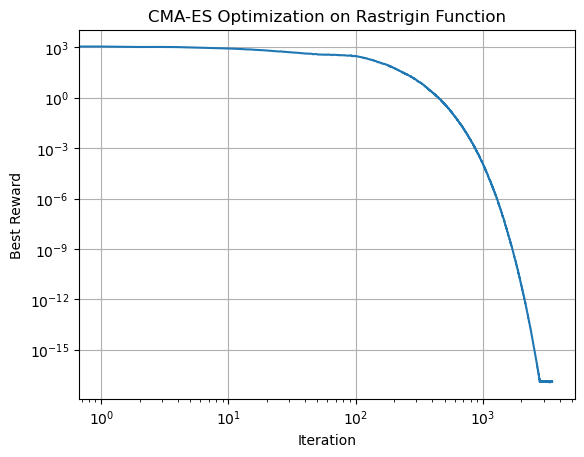

In [8]:
#use CMA-ES to optimize rastrigin function
epochs = 3500
N_dim = 1000
pop_size = 100

#init_pos = (upper_bound - lower_bound) * np.random.rand(N_dim, 1) + lower_bound
init_pos = 1 * np.ones([N_dim, 1])

CMA_optimizer = CMA_opt(N_dim, pop_size, select_pop=int(pop_size/2), sigma_init=0.5, mean_init=init_pos)
#CMA_optimizer.eigen_update_frequency = 1
#print('Initial position: ', init_pos)
#print rastrigin function value at initial position
print('Initial reward: ', f_sphere(init_pos))

best_reward_cma = np.zeros(epochs)

#create empty arrays to store rewards and coordinates at each iteration
rewards_cma = np.zeros([epochs, pop_size])
coordinates_cma = np.zeros([epochs, N_dim, pop_size])

for i in range(int(epochs)):
    #ask for new coordinates
    coordinates = CMA_optimizer.ask()
    coordinates = coordinates.T
    #compute rewards / value of function to optimize
    rewards = np.reshape(np.apply_along_axis(f_sphere, 1, coordinates.T), newshape=[np.shape(coordinates)[1], 1])
    # give rewards to optimizer for adaptation and mutation 
    CMA_optimizer.tell(reward_table=rewards)
    
    best_reward_cma[i] = np.min(rewards)
    #save history of rewards and coordinates
    rewards_cma[i, :] = rewards.T
    coordinates_cma[i, :, :] = coordinates
    
    if i%100==0:
        print('Best reward at iteration {}: {}'.format(i, np.min(rewards)))
        
# Plotting after all iterations
plt.loglog(best_reward_cma)
plt.xlabel('Iteration')
plt.ylabel('Best Reward')
plt.title('CMA-ES Optimization on Rastrigin Function')
plt.grid(True)
plt.show()


Best reward at iteration 0: 1161.2371614063836
Best reward at iteration 100: 527.4277652907554
Best reward at iteration 200: 223.418849142263
Best reward at iteration 300: 95.30942019653126
Best reward at iteration 400: 44.42719588303207
Best reward at iteration 500: 24.282131762814707
Best reward at iteration 600: 13.460828012221812
Best reward at iteration 700: 7.365372364620967
Best reward at iteration 800: 4.368555574565818
Best reward at iteration 900: 2.4102318100114504
Best reward at iteration 1000: 1.3585704771897638
Best reward at iteration 1100: 0.767536110163211
Best reward at iteration 1200: 0.4316588480677306
Best reward at iteration 1300: 0.23305692105726414
Best reward at iteration 1400: 0.13920779654970666
Best reward at iteration 1500: 0.09422665541644087
Best reward at iteration 1600: 0.08901144259050937
Best reward at iteration 1700: 0.09466084414762706
Best reward at iteration 1800: 0.09171789869567148
Best reward at iteration 1900: 0.09235249299337445


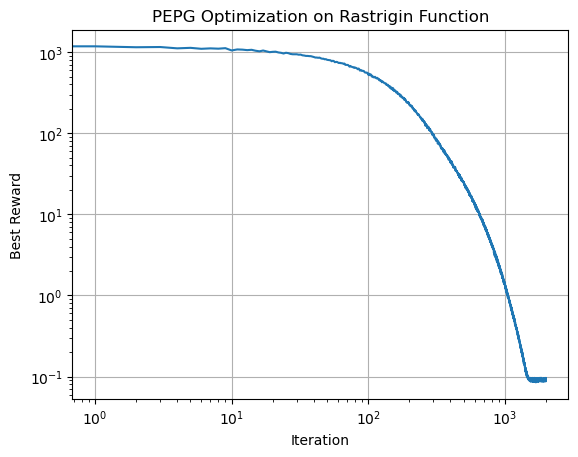

In [7]:
# use PEPG to optimize rastrigin function
epochs = 2000
N_dim = 1000
pop_size = 100

#create empty arrays to store rewards and coordinates at each iteration
rewards_pepg = np.zeros([epochs, pop_size])
coordinates_pepg = np.zeros([epochs, N_dim, pop_size])


#init_pos = (upper_bound - lower_bound) * np.random.rand(N_dim, 1) + lower_bound
init_pos = 1 * np.ones([N_dim, 1])

best_reward_pepg = np.zeros(epochs)

PEPG_optimizer = PEPG_opt(N_dim, pop_size, learning_rate=0.01, starting_mu=init_pos ,starting_sigma=0.5)

for i in range(epochs):
    
    coordinates = PEPG_optimizer.ask()
    coordinates = coordinates.T
    rewards = np.reshape(np.apply_along_axis(f_sphere, 1, coordinates.T), newshape=[np.shape(coordinates)[1], 1])
    rewards = rewards
    PEPG_optimizer.tell(rewards)
    
    best_reward_pepg[i] = np.min(rewards)
    #save history of rewards and coordinates
    rewards_pepg[i, :] = rewards.T
    coordinates_pepg[i, :, :] = coordinates
    
    if i%100==0:
        print('Best reward at iteration {}: {}'.format(i, np.min(rewards)))
        
# Plotting after all iterations
plt.loglog(best_reward_pepg)
plt.xlabel('Iteration')
plt.ylabel('Best Reward')
plt.title('PEPG Optimization on Rastrigin Function')
plt.grid(True)
plt.show()


Initial reward:  1000.0
Best reward at iteration 0: 998.5000000000748
Best reward at iteration 100: 980.224606415599
Best reward at iteration 200: 905.5883041677753
Best reward at iteration 300: 841.3256038147443
Best reward at iteration 400: 781.8872984728789
Best reward at iteration 500: 715.3342809995349
Best reward at iteration 600: 654.9408906172605
Best reward at iteration 700: 589.8466798012516
Best reward at iteration 800: 537.3174799076262
Best reward at iteration 900: 490.0490974936739
Best reward at iteration 1000: 445.8482198290101
Best reward at iteration 1100: 412.6549516497545
Best reward at iteration 1200: 373.2339041297424
Best reward at iteration 1300: 344.3032302084745
Best reward at iteration 1400: 312.9058375320677
Best reward at iteration 1500: 286.06537611818544
Best reward at iteration 1600: 257.5555157799088
Best reward at iteration 1700: 240.41750731862805
Best reward at iteration 1800: 216.5590192789113
Best reward at iteration 1900: 199.03059398027557
Best r

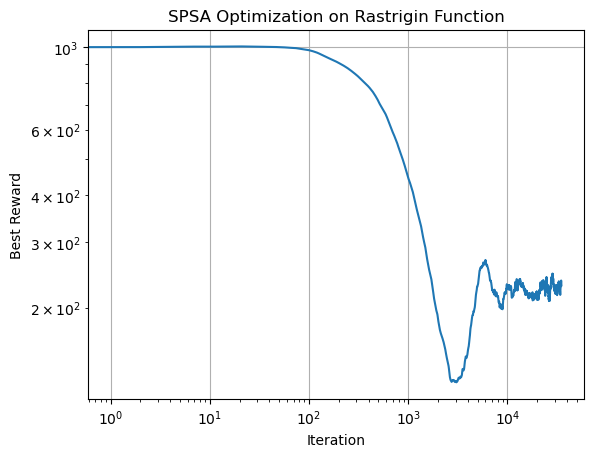

In [58]:
#use SPSA to optimize rastrigin function
epochs = 35000
N_dim = 1000
pop_size = 100

init_pos = (upper_bound - lower_bound) * np.random.rand(N_dim, 1) + lower_bound
init_pos = 1 * np.ones([N_dim, 1])

SPSA_optimizer = SPSA_opt(init_pos,alpha=1e-3,epsilon=0.0000001)
Adam = AdamOptimizer(init_pos, lr=3e-2, beta1=0.99, beta2=0.999, epsilon=1e-8)
#print('Initial position: ', init_pos)
#print rastrigin function value at initial position
print('Initial reward: ', f_sphere(init_pos))

best_reward_spsa = np.zeros(epochs)

#create empty arrays to store rewards and coordinates at each iteration
rewards_spsa = np.zeros([epochs, pop_size])
coordinates_spsa = np.zeros([epochs, N_dim])

for i in range(int(epochs)):
    #perturb parameters
    params_plus, params_minus = SPSA_optimizer.perturb_parameters() 
    #compute rewards / value of function to optimize
    reward_plus = np.apply_along_axis(f_sphere, 0, params_plus)
    reward_minus = np.apply_along_axis(f_sphere, 0, params_minus)

    # give rewards to optimizer for adaptation and mutation 
    grad = SPSA_optimizer.approximate_gradient(reward_plus ,reward_minus)
    step = Adam.step(grad)
    
    #coordinates_spsa[i, :] = SPSA_optimizer.update_parameters(grad).squeeze()
    coordinates_spsa[i, :] = SPSA_optimizer.update_parameters_step(step).squeeze()
    
    best_reward_spsa[i] = np.apply_along_axis(f_sphere, 0, SPSA_optimizer.params)[0]
    #save history of rewards and coordinates
    
    if i%100==0:
        print('Best reward at iteration {}: {}'.format(i, best_reward_spsa[i]))
        
# Plotting after all iterations
plt.loglog(best_reward_spsa)
plt.xlabel('Iteration')
plt.ylabel('Best Reward')
plt.title('SPSA Optimization on Rastrigin Function')
plt.grid(True)
plt.show()


Initial reward:  1000.0
Best reward at iteration 0: 810.0000000008998
Best reward at iteration 500: 1.5686482312576198e-20


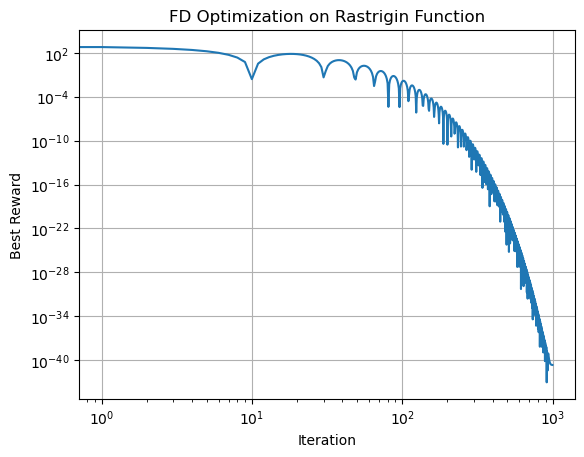

In [61]:
#Using finite difference to optimize rastrigin function
epochs = 1000
N_dim = 1000
grad_dim = 1000

init_pos = (upper_bound - lower_bound) * np.random.rand(N_dim, 1) + lower_bound
init_pos = 1 * np.ones([N_dim, 1])

FD_optimizer = FD_opt(init_pos,n_perturb=grad_dim,alpha=1e-3,epsilon=1e-5)
Adam = AdamOptimizer(init_pos, lr=1e-1, beta1=0.9, beta2=0.999, epsilon=1e-8)

#print rastrigin function value at initial position
print('Initial reward: ', f_sphere(init_pos))

best_reward_fd = np.zeros(epochs)

#create empty arrays to store rewards and coordinates at each iteration
coordinates_fd = np.zeros([epochs, N_dim])

FD_optimizer.n_perturb = grad_dim


for i in range(int(epochs)):
    grad = np.zeros([N_dim,1])
    FD_optimizer.generate_perturb_idx()
    for k in range(len(FD_optimizer.perturb_idx)):
        #perturb parameters
        params_plus, params_minus = FD_optimizer.perturb_parameters() 
        #compute rewards / value of function to optimize
        reward_plus = np.apply_along_axis(f_sphere, 0, params_plus)
        reward_minus = np.apply_along_axis(f_sphere, 0, params_minus)

        # give rewards to optimizer for adaptation and mutation 
        grad[FD_optimizer.perturb_idx[k]] = FD_optimizer.approximate_gradient(reward_plus ,reward_minus)
        
    
    step = Adam.step(grad)
    
    coordinates_fd[i, :] = FD_optimizer.update_parameters_step(step).squeeze()
    
    best_reward_fd[i] = np.apply_along_axis(f_sphere, 0, FD_optimizer.params)[0]
    #save history of rewards and coordinates
    
    if i%500==0:
        print('Best reward at iteration {}: {}'.format(i, best_reward_fd[i]))
        
# Plotting after all iterations
plt.loglog(best_reward_fd)
plt.xlabel('Iteration')
plt.ylabel('Best Reward')
plt.title('FD Optimization on Rastrigin Function')
plt.grid(True)
plt.show()


Initial reward:  1000.0
Best reward at iteration 0: 999.9801000000001
Best reward at iteration 500: 881.9380920706853
Best reward at iteration 1000: 724.9044334415728
Best reward at iteration 1500: 579.1374530908466
Best reward at iteration 2000: 446.2858223484548
Best reward at iteration 2500: 339.6911911980113
Best reward at iteration 3000: 256.0168000311621
Best reward at iteration 3500: 192.61583954444265
Best reward at iteration 4000: 147.25936592601326
Best reward at iteration 4500: 113.33314529627972
Best reward at iteration 5000: 94.92994668508112
Best reward at iteration 5500: 84.94422367775311
Best reward at iteration 6000: 80.38381884543611
Best reward at iteration 6500: 78.1389800606569
Best reward at iteration 7000: 77.03779854067893
Best reward at iteration 7500: 76.78689490277245
Best reward at iteration 8000: 76.7617933895849
Best reward at iteration 8500: 76.26353952788372
Best reward at iteration 9000: 76.98327667125886
Best reward at iteration 9500: 76.97980316365056

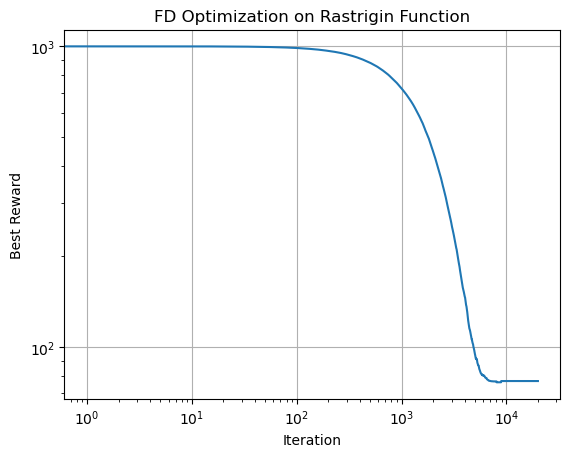

In [54]:
#Using finite difference to optimize rastrigin function
epochs = 20000
N_dim = 1000
grad_dim = 1

init_pos = (upper_bound - lower_bound) * np.random.rand(N_dim, 1) + lower_bound
init_pos = 1 * np.ones([N_dim, 1])

FD_optimizer = FD_opt(init_pos,n_perturb=grad_dim,alpha=1e-3,epsilon=1e-5)
Adam = AdamOptimizer(init_pos, lr=1e-2, beta1=0.9, beta2=0.999, epsilon=1e-8)

#print rastrigin function value at initial position
print('Initial reward: ', f_sphere(init_pos))

best_reward_fd_1 = np.zeros(epochs)

#create empty arrays to store rewards and coordinates at each iteration
coordinates_fd_1 = np.zeros([epochs, N_dim])

FD_optimizer.n_perturb = grad_dim


for i in range(int(epochs)):
    grad = np.zeros([N_dim,1])
    FD_optimizer.generate_perturb_idx()
    for k in range(len(FD_optimizer.perturb_idx)):
        #perturb parameters
        params_plus, params_minus = FD_optimizer.perturb_parameters() 
        #compute rewards / value of function to optimize
        reward_plus = np.apply_along_axis(f_sphere, 0, params_plus)
        reward_minus = np.apply_along_axis(f_sphere, 0, params_minus)

        # give rewards to optimizer for adaptation and mutation 
        grad[FD_optimizer.perturb_idx[k]] = FD_optimizer.approximate_gradient(reward_plus ,reward_minus)
        
    
    step = Adam.step(grad)
    
    coordinates_fd_1[i, :] = FD_optimizer.update_parameters_step(step).squeeze()
    
    best_reward_fd_1[i] = np.apply_along_axis(f_sphere, 0, FD_optimizer.params)[0]
    #save history of rewards and coordinates
    
    if i%500==0:
        print('Best reward at iteration {}: {}'.format(i, best_reward_fd_1[i]))
        
# Plotting after all iterations
plt.loglog(best_reward_fd_1)
plt.xlabel('Iteration')
plt.ylabel('Best Reward')
plt.title('FD Optimization on Rastrigin Function')
plt.grid(True)
plt.show()


C:\Users\Admin\AppData\Local\Temp\ipykernel_10208\1344202874.py:40: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)



Best reward at iteration 0: 118.69018367658325
Best reward at iteration 100: 44.980783241552466
Best reward at iteration 200: 43.2763019718575
Best reward at iteration 300: 40.32970760455731
Best reward at iteration 400: 35.371029979953725
Best reward at iteration 500: 33.56142158274066
Best reward at iteration 600: 30.753226239705793
Best reward at iteration 700: 28.813041713756245
Best reward at iteration 800: 27.34773720949004
Best reward at iteration 900: 24.577076873747313
Best reward at iteration 1000: 22.68239031711733
Best reward at iteration 1100: 22.12399845719767
Best reward at iteration 1200: 21.434842373917945
Best reward at iteration 1300: 20.400538075502226
Best reward at iteration 1400: 19.003428338179695
Best reward at iteration 1500: 17.926087354921567
Best reward at iteration 1600: 16.594224864885184
Best reward at iteration 1700: 16.070775857482868
Best reward at iteration 1800: 15.138223622417414
Best reward at iteration 1900: 14.77622701428809
Best reward at itera

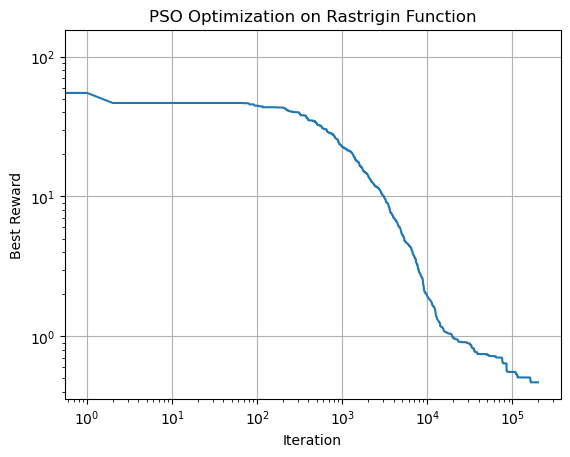

In [36]:
# use PSO to optimize rastrigin function
epochs = 200000
N_dim = 1000
pop_size = 100

#create empty arrays to store rewards and coordinates at each iteration
#rewards_pso = np.zeros([epochs, pop_size])
#coordinates_pso = np.zeros([epochs, N_dim, pop_size])


init_pos = (upper_bound - lower_bound) * np.random.rand(N_dim, pop_size) + lower_bound
#init_pos = 1 * np.ones([N_dim, pop_size])

#V_init = 0.1 * np.ones([N_dim, pop_size])
#random initial velocity
V_init = 0.1 * np.random.rand(N_dim, pop_size)

#params dictionary
params = {'c_1': 2.5, 
          'c_2': 0.85,
          'w': 0.7,
          'Vmax': 0.15*(upper_bound-lower_bound),
          'upper_bound': upper_bound,
          'lower_bound': lower_bound,
          }

best_reward_pso = np.zeros(epochs)

PSO_optimizer = PSO_opt(X_init = init_pos,V_init = V_init,params=params)
#PSO_optimizer.reward_history = np.zeros([epochs, pop_size])

for i in range(epochs):
    
    coordinates = PSO_optimizer.ask()

    rewards = np.reshape(np.apply_along_axis(f_sphere, 1, coordinates.T), newshape=[np.shape(coordinates)[1], 1])
    #PSO_optimizer.reward_history[i, :] = rewards.T
    PSO_optimizer.tell(rewards)
    
    best_reward_pso[i] = PSO_optimizer.best_reward
    #save history of rewards and coordinates
    #rewards_pso[i, :] = rewards.T
    #coordinates_pso[i, :, :] = coordinates
    
    if i%100==0:
        print('Best reward at iteration {}: {}'.format(i, np.min(rewards)))
        
# Plotting after all iterations
plt.loglog(best_reward_pso)
plt.xlabel('Iteration')
plt.ylabel('Best Reward')
plt.title('PSO Optimization on Rastrigin Function')
plt.grid(True)
plt.show()


In [55]:

cma_time = 118
pepg_time = 4.2
pso_time = 422
spsa_time = 7.5
fd_time = 62
fd_1_time = 3.3

fig = make_subplots(rows=1, cols = 3,shared_yaxes=True, 
                    subplot_titles=["Performance vs epochs", "Performance vs runtime", "Performance vs function evaluations"])


fig.add_trace(go.Scatter(x=np.arange(3500), y=best_reward_cma, mode='lines', name='CMA-ES',showlegend = False,
                         line=dict(color='firebrick', width=2)), row=1, col=1)
fig.add_trace(go.Scatter(x=np.arange(2000), y=best_reward_pepg, mode='lines', name='PEPG',showlegend=False,
                         line=dict(color='forestgreen', width=2)), row=1, col=1)
fig.add_trace(go.Scatter(x=np.arange(200000), y=best_reward_pso, mode='lines', name='PSO',showlegend=False,
                         line=dict(color='slategrey', width=2)), row=1, col=1)
fig.add_trace(go.Scatter(x=np.arange(35000), y=best_reward_spsa, mode='lines', name='SPSA',showlegend= False,
                         line=dict(color='deepskyblue', width=2)), row=1, col=1)
fig.add_trace(go.Scatter(x=np.arange(1000), y=best_reward_fd, mode='lines', name='FD N',showlegend= False,
                         line=dict(color='coral', width=2)), row=1, col=1)
fig.add_trace(go.Scatter(x=np.arange(20000), y=best_reward_fd_1, mode='lines', name='FD 1',showlegend= False,
                         line=dict(color='gold', width=2)), row=1, col=1)

fig.update_xaxes(title_text="Epochs",type = 'log',exponentformat="power", row=1, col=1)
fig.update_yaxes(title_text="f(x)", type = 'log',exponentformat="power",row=1, col=1)


fig.add_trace(go.Scatter(x=np.linspace(0,cma_time,len(best_reward_cma)), y=best_reward_cma, mode='lines', name='CMA-ES',
                         line=dict(color='firebrick', width=2)), row=1, col=2)
fig.add_trace(go.Scatter(x=np.linspace(0,pepg_time,len(best_reward_pepg)), y=best_reward_pepg, mode='lines', name='PEPG',
                         line=dict(color='forestgreen', width=2)), row=1, col=2)
fig.add_trace(go.Scatter(x=np.linspace(0,pso_time,len(best_reward_pso)), y=best_reward_pso, mode='lines', name='PSO',
                         line=dict(color='slategrey', width=2)), row=1, col=2)
fig.add_trace(go.Scatter(x=np.linspace(0,spsa_time,len(best_reward_spsa)), y=best_reward_spsa, mode='lines', name='SPSA',
                         line=dict(color='deepskyblue', width=2)), row=1, col=2)
fig.add_trace(go.Scatter(x=np.linspace(0,fd_time,len(best_reward_fd)), y=best_reward_fd, mode='lines', name='FD N',
                         line=dict(color='coral', width=2)), row=1, col=2)
fig.add_trace(go.Scatter(x=np.linspace(0,fd_1_time,len(best_reward_fd_1)), y=best_reward_fd, mode='lines', name='FD 1',
                         line=dict(color='gold', width=2)), row=1, col=2)

fig.update_xaxes(title_text="Time [s]",type = 'log',exponentformat="power", row=1, col=2)
fig.update_yaxes( type = 'log',row=1, col=2)


fig.add_trace(go.Scatter(x=np.arange(3500)*100, y=best_reward_cma, mode='lines', name='CMA-ES',showlegend = False,
                         line=dict(color='firebrick', width=2)), row=1, col=3)
fig.add_trace(go.Scatter(x=np.arange(2000)*100, y=best_reward_pepg, mode='lines', name='PEPG',showlegend=False,
                         line=dict(color='forestgreen', width=2)), row=1, col=3)
fig.add_trace(go.Scatter(x=np.arange(200000)*100, y=best_reward_pso, mode='lines', name='PSO',showlegend=False,
                         line=dict(color='slategrey', width=2)), row=1, col=3)
fig.add_trace(go.Scatter(x=np.arange(35000)*2, y=best_reward_spsa, mode='lines', name='SPSA',showlegend= False,
                         line=dict(color='deepskyblue', width=2)), row=1, col=3)
fig.add_trace(go.Scatter(x=np.arange(1000)*1000, y=best_reward_fd, mode='lines', name='FD N',showlegend= False,
                         line=dict(color='coral', width=2)), row=1, col=3)
fig.add_trace(go.Scatter(x=np.arange(20000)*1, y=best_reward_fd, mode='lines', name='FD 1',showlegend= False,
                         line=dict(color='gold', width=2)), row=1, col=3)

fig.update_xaxes(title_text="# function evaluations",type = 'log',exponentformat="power", row=1, col=3)
fig.update_yaxes( type = 'log',row=1, col=3)
# limit y axis range
fig.update_yaxes(range=[-4, 4])
fig.update_layout(height = 300,width = 1000,template="plotly_white", margin=dict(l=20, r=20, t=20, b=20))

In [62]:
#saving the data to txt files for processing
# save to csv file

savetxt('data\\Results\\Sphere\\best_reward_cma.csv', best_reward_cma, delimiter=',')
savetxt('data\\Results\\Sphere\\best_reward_pepg.csv', best_reward_pepg, delimiter=',')
savetxt('data\\Results\\Sphere\\best_reward_pso.csv', best_reward_pso, delimiter=',')
savetxt('data\\Results\\Sphere\\best_reward_spsa.csv', best_reward_spsa, delimiter=',')
savetxt('data\\Results\\Sphere\\best_reward_fd_1000.csv', best_reward_fd, delimiter=',')
savetxt('data\\Results\\Sphere\\best_reward_fd_1.csv', best_reward_fd_1, delimiter=',')

conv_time = np.array([cma_time, pepg_time, pso_time, spsa_time, fd_time, fd_1_time])
num_epochs = np.array([3500, 2000, 200000, 35000, 1000,20000])
savetxt('data\\Results\\Sphere\\time.csv', conv_time, delimiter=',')
savetxt('data\\Results\\Sphere\\epochs.csv', num_epochs, delimiter=',')



In [ ]:
# this is using plotly it looks much better
epochs_to_plot = [0, 100, 500, 1000, 1500, 2000, 2500,2900]
# Create subplots
fig = make_subplots(rows=2, cols=4, subplot_titles=[f'Epoch {epoch}' for epoch in epochs_to_plot],
                    horizontal_spacing=0.02, vertical_spacing=0.1)

# Index for accessing epochs to plot
k = 0

for i in range(1, 3):
    for j in range(1, 5):
        # Add contour plot of the Rastrigin function
        fig.add_trace(go.Contour(z=F_2, x=X_1[0, :], y=X_2[:, 0], colorscale='Turbo', contours_coloring='fill',  # Fill the contours
                                line_width=0, showscale=False, 
                                 name='', hoverinfo='skip'), row=i, col=j)
        
        # Add scatter plot for the distribution of coordinates
        fig.add_trace(go.Scatter(x=coordinates_cma[epochs_to_plot[k], 0, :], 
                                 y=coordinates_cma[epochs_to_plot[k], 1, :], mode='markers',
                                 marker=dict(color='white', size=5, opacity=0.8, line=dict(color='black', width=1)),
                                 name='Population',showlegend=(k==0)), row=i, col=j)
        
        # Add scatter plot for the mean of the distribution
        fig.add_trace(go.Scatter(x=[np.mean(coordinates_cma[epochs_to_plot[k], 0, :])], 
                                 y=[np.mean(coordinates_cma[epochs_to_plot[k], 1, :])], mode='markers',
                                 marker=dict(color='darkred', size=10, line=dict(color='white', width=1)),
                                 name='Mean',showlegend=(k==0)), row=i, col=j)
        
        # Set axis limits
        fig.update_xaxes(range=[lower_bound, upper_bound], row=i, col=j)
        fig.update_yaxes(range=[lower_bound, upper_bound], row=i, col=j)
        
        k += 1

# Update layout
fig.update_layout(title_text='CMA-ES Optimization on Rastrigin Function', height=500, width=900)

fig.show()

In [ ]:
# this is using plotly it looks much better

epochs_to_plot = [0, 100, 500, 1000, 1500, 2000, 2500,2900]
# Create subplots
fig = make_subplots(rows=2, cols=4, subplot_titles=[f'Epoch {epoch}' for epoch in epochs_to_plot],
                    horizontal_spacing=0.02, vertical_spacing=0.1)

# Index for accessing epochs to plot
k = 0

for i in range(1, 3):
    for j in range(1, 5):
        # Add contour plot of the Rastrigin function
        fig.add_trace(go.Contour(z=F_2, x=X_1[0, :], y=X_2[:, 0], colorscale='Turbo', contours_coloring='fill',  # Fill the contours
                                line_width=0, showscale=False, 
                                 name='', hoverinfo='skip'), row=i, col=j)
        
        # Add scatter plot for the distribution of coordinates
        fig.add_trace(go.Scatter(x=coordinates_pepg[epochs_to_plot[k], 0, :], 
                                 y=coordinates_pepg[epochs_to_plot[k], 1, :], mode='markers',
                                 marker=dict(color='white', size=5, opacity=0.8, line=dict(color='black', width=1)),
                                 name='Population',showlegend=(k==0)), row=i, col=j)
        
        # Add scatter plot for the mean of the distribution
        fig.add_trace(go.Scatter(x=[np.mean(coordinates_pepg[epochs_to_plot[k], 0, :])], 
                                 y=[np.mean(coordinates_pepg[epochs_to_plot[k], 1, :])], mode='markers',
                                 marker=dict(color='darkred', size=10, line=dict(color='white', width=1)),
                                 name='Mean',showlegend=(k==0)), row=i, col=j)
        
        # Set axis limits
        fig.update_xaxes(range=[lower_bound, upper_bound], row=i, col=j)
        fig.update_yaxes(range=[lower_bound, upper_bound], row=i, col=j)
        
        k += 1

# Update layout
fig.update_layout(title_text='PEPG Optimization on Rastrigin Function', height=500, width=900)

fig.show()